# ESTI019 - Codificação de Sinais Multimídia
# Lab8 - Codificação de Voz e Áudio
## Profs. Celso S. Kurashima e Mário Minami

<h2> OBJETIVOS </h2>
. Determinação dos parâmetros LPC
. Separação Sonora/Surda
. Espectro e Envoltória LP
. Comparação de Codificações MPEG


In [1]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt
import librosa
import librosa.display
import IPython.display
import math

## Separação de uma Estrofe

In [2]:
audio1 = 'Entre_Leva_Catia_Falada.wav'
print(audio1)
v1 , sr1 = librosa.load(audio1)
print(type(v1), type(sr1))
print(v1.shape, sr1)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v1, rate=sr1)

Entre_Leva_Catia_Falada.wav
<class 'numpy.ndarray'> <class 'int'>
(292805,) 22050


Text(0.5, 1.0, 'Voz da CatiaEntre_Leva_Catia_Falada.wav')

<Figure size 432x288 with 0 Axes>

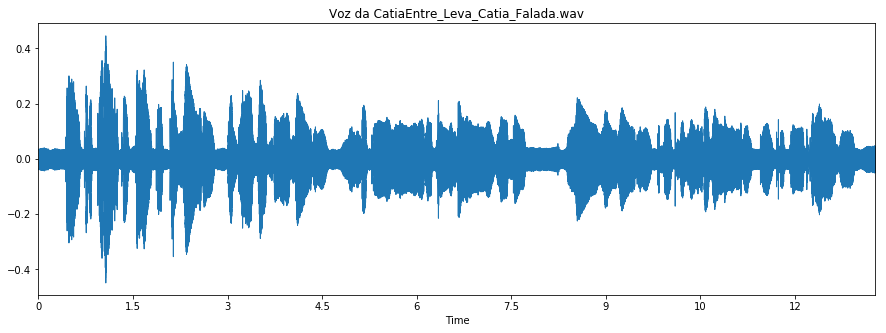

In [3]:
plt.figure()
fig, ax = plt.subplots(figsize=(15, 5))
librosa.display.waveplot(v1, sr=sr1)
plt.title('Voz da Catia' + audio1)

In [4]:
fa = sr1
Ts = 0.04
Nj = int(Ts*fa)
Nseg = int(len(v1)/Nj)
Nover = int(Nj*0.5)

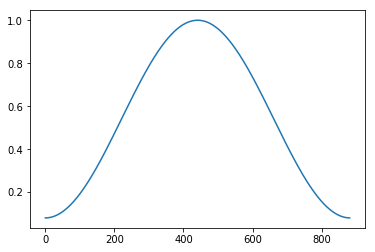

In [5]:
from scipy import signal
hm = signal.get_window('hamming', Nj)
plt.plot(hm)

<class 'numpy.ndarray'> <class 'int'>
(64999,) 22050


<Figure size 432x288 with 0 Axes>

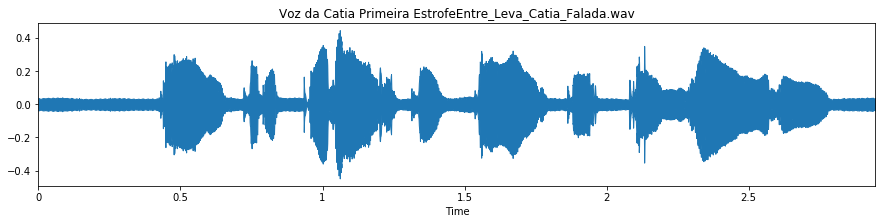

In [6]:
# Só a primeira estrofe
v11 = v1[1:65000]
plt.figure()
fig11, ax11 = plt.subplots(figsize=(15, 3))
librosa.display.waveplot(v11, sr=sr1)
plt.title('Voz da Catia Primeira Estrofe' + audio1)
print(type(v11), type(sr1))
print(v11.shape, sr1)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v11, rate=sr1)

## Cálculo dos Parâmetros LPC, separação U/UV e Espectro + Envoltória LPC

In [7]:
import audiolazy as lz

Limiar VAD -27.679054847888903
Limiar U/UV -24.979054847888904
Sonoros = 28 e Surdos = 8


IndexError: index 71 is out of bounds for axis 0 with size 71

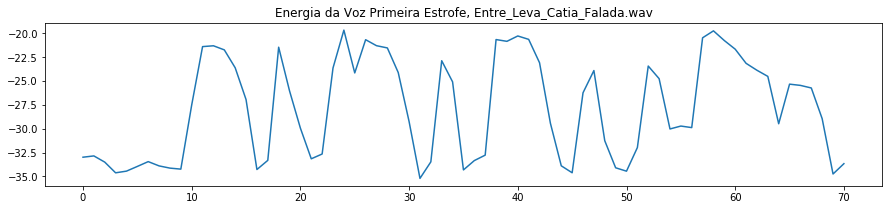

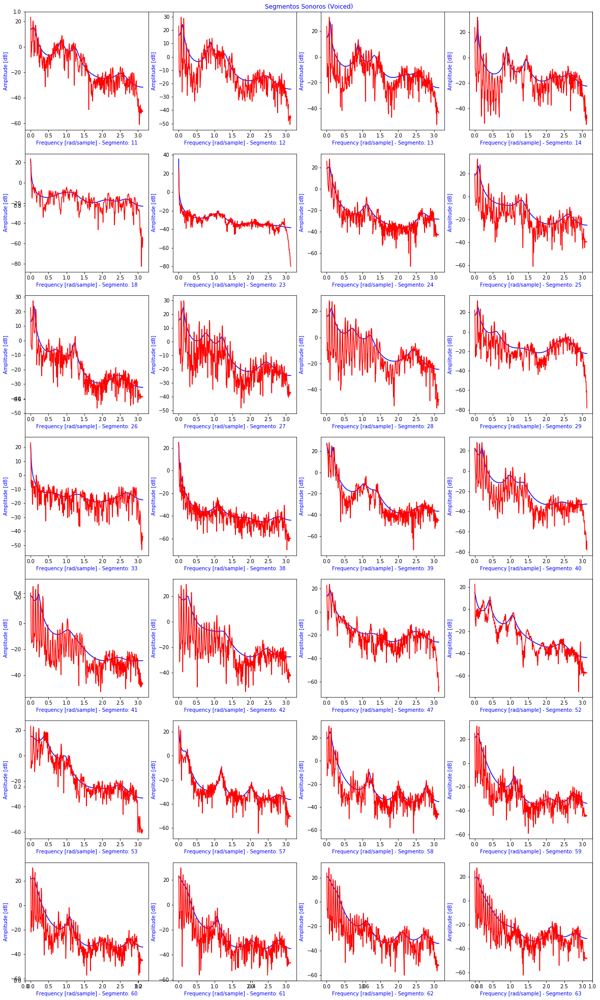

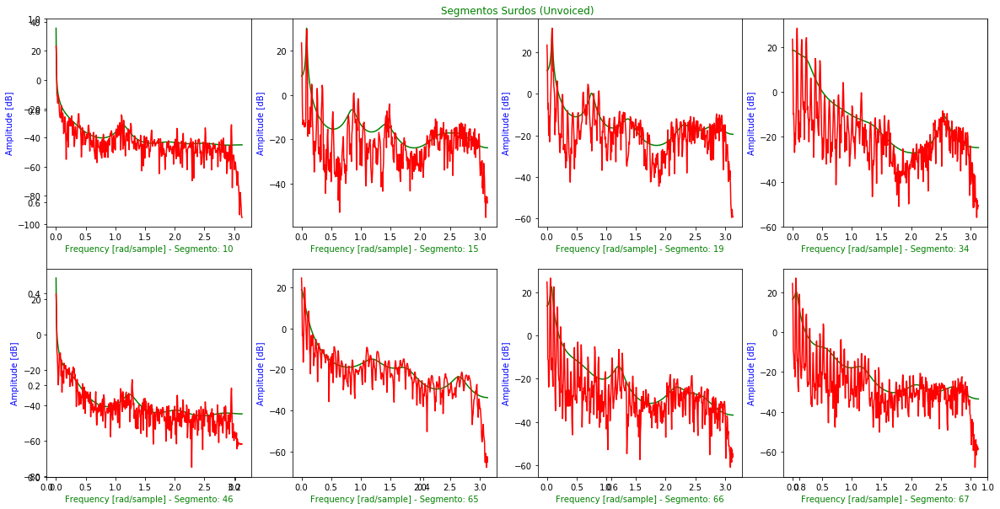

In [8]:
Nover = int(Nj*0.5)
Nseg1 = int(len(v11)/Nj)
p = 10
E = []
ind_voz = [0]*Nseg1
t = np.arange(Nj)
for l in range(1, Nseg1-1):
    xjan = v1[(l-1)*Nj+Nover:l*Nj+Nover]*hm
    x2 = list(np.array(xjan**2))
    aux = sum(x2)/Nj
    E.append(aux)
E1 = 10*np.log10(E)
E1max = np.max(E1)
# limiar de atividade VAD
E1VAD_lim = E1max - 8
print('Limiar VAD ' + str(E1VAD_lim))
# Limiar U/UV ajustado para 30% do máximo
E1voiced_lim = E1max - 5.3 
print('Limiar U/UV ' + str(E1voiced_lim))
# indicador de VAD
ind_voz = np.where(E1 > E1VAD_lim, 1, 0)
ind_voiced = np.where(E1 > E1voiced_lim, 1, 0)
tot_voz = np.sum(ind_voz)
num_voiced = np.sum(ind_voiced)
num_unvoiced = tot_voz - num_voiced
linhas_voiced = math.ceil(num_voiced/4)
linhas_unvoiced = math.ceil(num_unvoiced/4)

print('Sonoros = ' + str(num_voiced) + ' e Surdos = ' + str(num_unvoiced) )
fig1, ax1 = plt.subplots(figsize=(15, 3))
plt.figure(1)
plt.plot(E1)
plt.title('Energia da Voz Primeira Estrofe, ' + audio1)

# partição das figuras voiced
i = 0
fig2, ax2 = plt.subplots(figsize=(20, num_voiced + linhas_voiced))
plt.title('Segmentos Sonoros (Voiced)', color = 'b')

# partição das figuras unvoiced
j = 0
fig3, ax3 = plt.subplots(figsize=(20, num_unvoiced + linhas_unvoiced))
plt.title('Segmentos Surdos (Unvoiced)', color = 'g')

for l in range(1, Nseg1-1):
    # teste de VAD 
    if ind_voz[l] == 1:
        xjan = v1[(l-1)*Nj+Nover:l*Nj+Nover]*hm
        a_filter = lz.lpc.kautocor(xjan, p) 
        gain_lpc = np.log10(abs(a_filter.error))
        w, h = signal.freqz(1,a_filter.numerator,worN=int(Nj/2))
        LP = 20 * np.log10(abs(h)) + 10*gain_lpc
        # Teste U/UV
       
        if E1[l] > E1voiced_lim:
            
            i += 1
            ax2 = fig2.add_subplot(linhas_voiced,4,i)
            plt.figure(2)          
            plt.plot(w, LP, 'b')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='b')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'r')
        else:
            
            j += 1
            ax3 = fig3.add_subplot(linhas_unvoiced,4,j)           
            plt.figure(3)            
            plt.plot(w, LP, 'g')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='g')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'r')    
        


        

## Mesmo procedimento para voz cantada

In [ ]:
audio2 = './DinamicoSoloCapacitivoCoro.wav'
print(audio2)
v2 , sr2 = librosa.load(audio2)
print(type(v2), type(sr2))
print(v2.shape, sr2)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v2, rate=sr2)

In [ ]:
plt.figure()
fig, ax = plt.subplots(figsize=(15, 5))
librosa.display.waveplot(v2, sr=sr2)
plt.title('Beatles' + audio2)

In [ ]:
# Só a início
v21 = v2[1:220000]
plt.figure()
fig21, ax21 = plt.subplots(figsize=(15, 3))
librosa.display.waveplot(v21, sr=sr2)
plt.title('Beatles Início' + audio2)
print(type(v21), type(sr2))
print(v21.shape, sr2)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v21, rate=sr2)

In [ ]:
Nover = int(Nj*0.5)
Nseg1 = int(len(v11)/Nj)
p = 10
E = []
ind_voz = [0]*Nseg1
t = np.arange(Nj)
for l in range(1, Nseg1-1):
    xjan = v2[(l-1)*Nj+Nover:l*Nj+Nover]*hm
    x2 = list(np.array(xjan**2))
    aux = sum(x2)/Nj
    E.append(aux)
E1 = 10*np.log10(E)
E1max = np.max(E1)
# limiar de atividade VAD
E1VAD_lim = E1max - 8
print('Limiar VAD ' + str(E1VAD_lim))
# Limiar U/UV ajustado para 30% do máximo
E1voiced_lim = E1max - 5.3 
print('Limiar U/UV ' + str(E1voiced_lim))
# indicador de VAD
ind_voz = np.where(E1 > E1VAD_lim, 1, 0)
ind_voiced = np.where(E1 > E1voiced_lim, 1, 0)
tot_voz = np.sum(ind_voz)
num_voiced = np.sum(ind_voiced)
num_unvoiced = tot_voz - num_voiced
linhas_voiced = math.ceil(num_voiced/4)
linhas_unvoiced = math.ceil(num_unvoiced/4)

print('Sonoros = ' + str(num_voiced) + ' e Surdos = ' + str(num_unvoiced) )
fig1, ax1 = plt.subplots(figsize=(15, 3))
plt.figure(1)
plt.plot(E1)
plt.title('Energia da Voz Cantada Início, ' + audio2)

# partição das figuras voiced
i = 0
fig2, ax2 = plt.subplots(figsize=(20, num_voiced + linhas_voiced))
plt.title('Segmentos Sonoros (Voiced)', color = 'k')

# partição das figuras unvoiced
j = 0
fig3, ax3 = plt.subplots(figsize=(20, num_unvoiced + linhas_unvoiced))
plt.title('Segmentos Surdos (Unvoiced)', color = 'm')

for l in range(1, Nseg1-1):
    # teste de VAD 
    if ind_voz[l] == 1:
        xjan = v2[(l-1)*Nj+Nover:l*Nj+Nover]*hm
        a_filter = lz.lpc.kautocor(xjan, p) 
        gain_lpc = np.log10(abs(a_filter.error))
        w, h = signal.freqz(1,a_filter.numerator,worN=int(Nj/2))
        LP = 20 * np.log10(abs(h)) + 10*gain_lpc
        # Teste U/UV
       
        if E1[l] > E1voiced_lim:
            
            i += 1
            ax2 = fig2.add_subplot(linhas_voiced,4,i)
            plt.figure(2)          
            plt.plot(w, LP, 'k')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='k')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'y')
        else:
            
            j += 1
            ax3 = fig3.add_subplot(linhas_unvoiced,4,j)           
            plt.figure(3)            
            plt.plot(w, LP, 'm')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='m')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'y')    


## Mesmo procedimento para voz falada

In [ ]:
audio2 = './HiroDinamico.wav'
print(audio2)
v2 , sr2 = librosa.load(audio2)
print(type(v2), type(sr2))
print(v2.shape, sr2)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v2, rate=sr2)

In [ ]:
plt.figure()
fig, ax = plt.subplots(figsize=(15, 5))
librosa.display.waveplot(v2, sr=sr2)
plt.title('Hiro Porta' + audio2)

In [ ]:
# Só a início
v21 = v2[1:220000]
plt.figure()
fig21, ax21 = plt.subplots(figsize=(15, 3))
librosa.display.waveplot(v21, sr=sr2)
plt.title('Hiro Porta Início' + audio2)
print(type(v21), type(sr2))
print(v21.shape, sr2)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=v21, rate=sr2)

In [ ]:
Nover = int(Nj*0.5)
Nseg1 = int(len(v11)/Nj)
p = 10
E = []
ind_voz = [0]*Nseg1
t = np.arange(Nj)
for l in range(1, Nseg1-1):
    xjan = v2[(l-1)*Nj+Nover:l*Nj+Nover]*hm
    x2 = list(np.array(xjan**2))
    aux = sum(x2)/Nj
    E.append(aux)
E1 = 10*np.log10(E)
E1max = np.max(E1)
# limiar de atividade VAD
E1VAD_lim = E1max - 8
print('Limiar VAD ' + str(E1VAD_lim))
# Limiar U/UV ajustado para 30% do máximo
E1voiced_lim = E1max - 5.3 
print('Limiar U/UV ' + str(E1voiced_lim))
# indicador de VAD
ind_voz = np.where(E1 > E1VAD_lim, 1, 0)
ind_voiced = np.where(E1 > E1voiced_lim, 1, 0)
tot_voz = np.sum(ind_voz)
num_voiced = np.sum(ind_voiced)
num_unvoiced = tot_voz - num_voiced
linhas_voiced = math.ceil(num_voiced/4)
linhas_unvoiced = math.ceil(num_unvoiced/4)

print('Sonoros = ' + str(num_voiced) + ' e Surdos = ' + str(num_unvoiced) )
fig1, ax1 = plt.subplots(figsize=(15, 3))
plt.figure(1)
plt.plot(E1)
plt.title('Energia da Voz Falada Início, ' + audio2)

# partição das figuras voiced
i = 0
fig2, ax2 = plt.subplots(figsize=(20, num_voiced + linhas_voiced))
plt.title('Segmentos Sonoros (Voiced)', color = 'k')

# partição das figuras unvoiced
j = 0
fig3, ax3 = plt.subplots(figsize=(20, num_unvoiced + linhas_unvoiced))
plt.title('Segmentos Surdos (Unvoiced)', color = 'm')

for l in range(1, Nseg1-1):
    # teste de VAD 
    if ind_voz[l] == 1:
        xjan = v2[(l-1)*Nj+Nover:l*Nj+Nover]*hm
        a_filter = lz.lpc.kautocor(xjan, p) 
        gain_lpc = np.log10(abs(a_filter.error))
        w, h = signal.freqz(1,a_filter.numerator,worN=int(Nj/2))
        LP = 20 * np.log10(abs(h)) + 10*gain_lpc
        # Teste U/UV
       
        if E1[l] > E1voiced_lim:
            
            i += 1
            ax2 = fig2.add_subplot(linhas_voiced,4,i)
            plt.figure(2)          
            plt.plot(w, LP, 'k')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='k')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'y')
        else:
            
            j += 1
            ax3 = fig3.add_subplot(linhas_unvoiced,4,j)           
            plt.figure(3)            
            plt.plot(w, LP, 'm')
            plt.ylabel('Amplitude [dB]', color='b')
            plt.xlabel('Frequency [rad/sample] - Segmento: ' + str(l), color='m')     
            sp = np.fft.fft(xjan)
            plt.plot(w, 20*np.log10(abs(sp[0:int(Nj/2)])), 'y')    


## 2a Parte - Codificação Mp3

<h3> Utilizando um arquivo .wav (p.ex Abba0.wav), codifique para .mp3 com o Goldwave
    nas taxas 320k, 128k e 32k, salvando cada um e comparando: </h3>
    <h4> i - o tamanho dos arquivos </h4>
    <h4> ii - o espectrograma de cada arquivo </h4>

Depois de converter o arquivo (usando o GoldWave) em "Save As" | "Tipo" | "Attibutes", para .mp3 com de taxas de 32kbps, 128kbps e 320kbps.
Usando novamente o Goldwave, por exemplo, restaurar a versão equivalente em .wav, para poder ser lida pelo python.
Assim gerar os espectrogramas equivalentes.

<h3> Leitura de arquivo de 32kbps e espectrograma equivalente </h3>

In [12]:
import os
os.listdir()

['.ipynb_checkpoints',
 'abba0.wav',
 'abba0__128k.wav',
 'abba0__320k.wav',
 'abba0__32k.wav',
 'DinamicoSoloCapacitivoCoro.wav',
 'DinamicoSoloCapacitivoCoro__128k.wav',
 'DinamicoSoloCapacitivoCoro__320k.wav',
 'DinamicoSoloCapacitivoCoro__32k.wav',
 'Entre_Leva_Catia_cantada.wav',
 'Entre_Leva_Catia_Falada.wav',
 'Lab8_CodificacaoVoz_Audio.ipynb']

In [14]:
abba32k = 'abba0__32k.wav'
print(abba32k)
m1 , sr32 = librosa.load(abba32k)
print(type(m1), type(sr32))
print(m1.shape, sr32)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=m1, rate=sr32)

abba0__32k.wav
<class 'numpy.ndarray'> <class 'int'>
(3041856,) 22050


Text(0.5, 1.0, 'Linear-frequency power spectrogramabba0__32k.wav')

<Figure size 720x720 with 0 Axes>

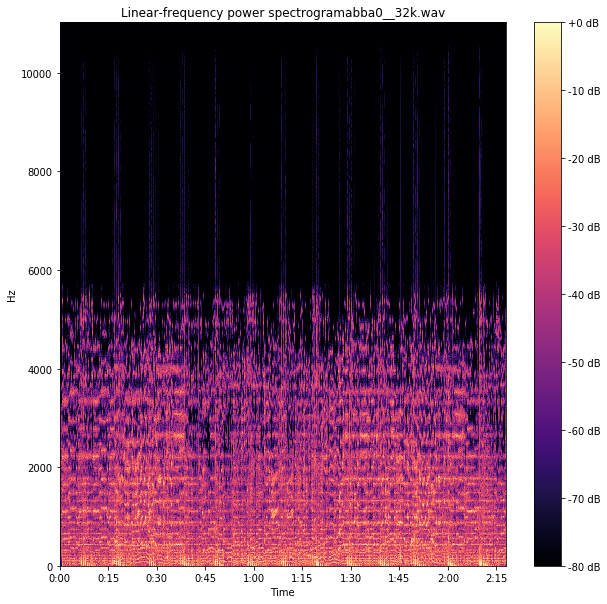

In [15]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
D = librosa.amplitude_to_db(np.abs(librosa.stft(m1)), ref=np.max)
fig, ax = plt.subplots(figsize=(10, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram'+ abba32k)

<h3> Leitura de arquiv de 128kbps e espectrograma equivalente </h3>

In [18]:
abba128k = './abba0__128k.wav'
print(abba128k)
m2 , sr128 = librosa.load(abba128k)
print(type(m2), type(sr128))
print(m2.shape, sr128)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=m2, rate=sr128)

./abba0__128k.wav
<class 'numpy.ndarray'> <class 'int'>
(3041856,) 22050


Text(0.5, 1.0, 'Linear-frequency power spectrogram./abba0__128k.wav')

<Figure size 864x1296 with 0 Axes>

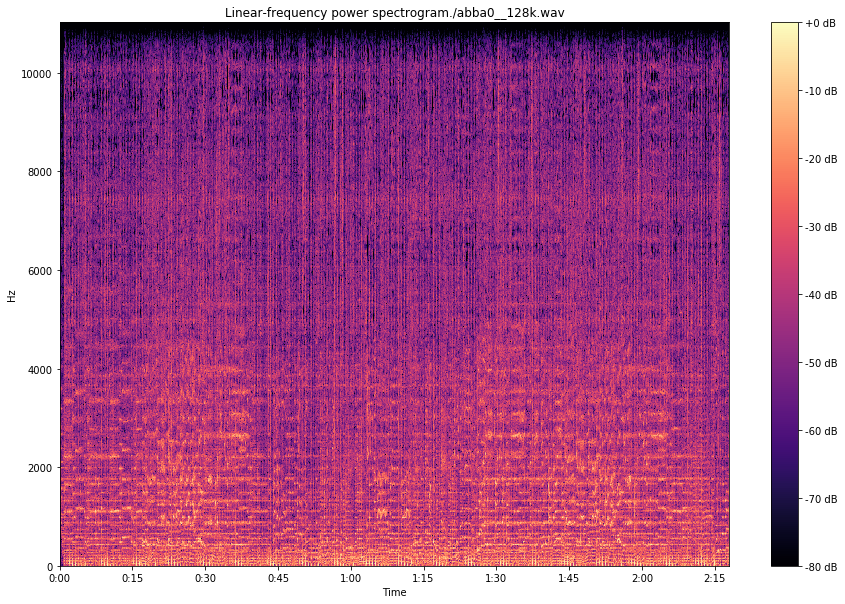

In [19]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 18))
D = librosa.amplitude_to_db(np.abs(librosa.stft(m2)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram'+ abba128k)

<h3> Leitura de arquiv de 320kbps e espectrograma equivalente </h3>

In [16]:
abba320k = './abba0__320k.wav'
print(abba320k)
m3 , sr320 = librosa.load(abba320k)
print(type(m3), type(sr320))
print(m3.shape, sr320)
# Player será aberto! AGUARDE até abrir!
IPython.display.Audio(data=m3, rate=sr320)

./abba0__320k.wav
<class 'numpy.ndarray'> <class 'int'>
(3041180,) 22050


Text(0.5, 1.0, 'Linear-frequency power spectrogram./abba0__320k.wav')

<Figure size 864x1296 with 0 Axes>

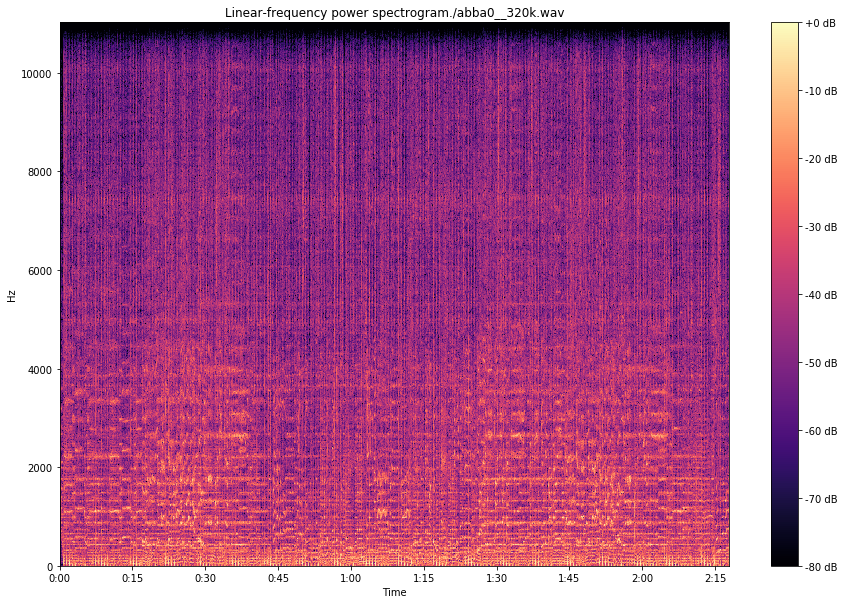

In [17]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 18))
D = librosa.amplitude_to_db(np.abs(librosa.stft(m3)), ref=np.max)
fig, ax = plt.subplots(figsize=(15, 10))
librosa.display.specshow(D, x_axis='time',y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram'+ abba320k)

## Agora com uma música da preferência do grupo
<h3> Repitir o procedimento para uma música em .wav da preferência do grupo </h3>

# No site
<h2> apresente as formas de onda e os principais resultados, incluindo os áudios utilizados </h2>
<h2> apresente os espectrogramas de trechos dos áudios codificados, e os arquivos codificados, comparando-os </h2>